# Datasets 
    
####    1. [Energy consumption dataset Helsinki](https://www.avoindata.fi/data/fi/dataset/helsingin-kaupungin-palvelukiinteistojen-energiankulutustietoja)

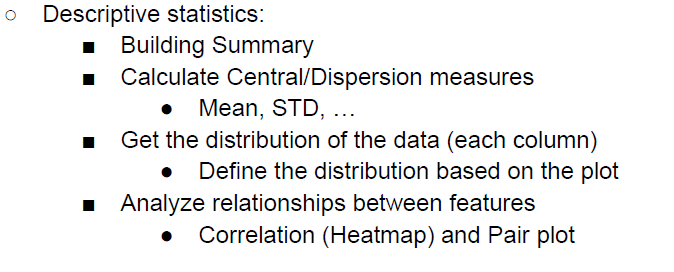

### Energy consumption data of city of Helsinki’s utility and service properties
Nuuka open API is a channel for fetching the basic information and energy data of Helsinki’s utility and service properties. The property endpoints are useful for finding the desired property and the additional information related to it, including the buildings that the property consist of. The possible categories for energy data are energy, heat, water and cooling. The data can be fetched on monthly, daily and hourly levels.


Nuuka open API is an interface for fetching the basic information and energy data of Helsinki’s utility and service properties. It requires no authentication.
The Property endpoints are useful for finding the desired property and the additional information related to it, including the buildings that the property consist of.
Possible categories for energy data are energy, heat, water and cooling. The data can be fetched on monthly, daily and hourly levels.
Availability of different levels of precisions depends on time and the property in question. The most precise hourly data is generally available from 2015 onwards.
The data is updated once a day, and the results are returned in JSON format.
The stored data is not thoroughly validated, and can contain errors.

In [ ]:
import os
import pandas as pd
import requests
import json

df1 = pd.read_json('List.json')

# Create a list of location names with space replacement
location_names = [location.replace(" ", "%20") for location in df1['locationName']]

# List to store URLs with valid JSON data
valid_urls = []

# Fetch data for each location
for location in location_names:
    url = f"https://helsinki-openapi.nuuka.cloud/api/v1.0/EnergyData/Daily/ListByProperty?Record=LocationName&SearchString={location}&ReportingGroup=Electricity&StartTime=2019-01-01&EndTime=2019-12-31"
    response = requests.get(url)
    data = response.json()
    if 'errorCode' not in data or data['errorCode'] != 'MissingSettingsException':
        valid_urls.append(url)

# Create a folder to store the JSON files
folder_name = "energy_data"
os.makedirs(folder_name, exist_ok=True)

# Save data from each valid URL as a separate JSON file in the folder
for index, url in enumerate(valid_urls):
    response = requests.get(url)
    data = response.json()
    filename = f"data_{index}.json"
    file_path = os.path.join(folder_name, filename)
    with open(file_path, 'w') as file:
        json.dump(data, file)
    print(f"Data saved for URL: {url} (filename: {filename})")

print("Data saved successfully.")


In [ ]:
import os
import json

folder_name = "energy_data"

# List all JSON files in the folder
json_files = [file for file in os.listdir(folder_name) if file.endswith(".json")]

# List to store merged data
merged_data = []

# Read and merge data from each JSON file
for file in json_files:
    file_path = os.path.join(folder_name, file)
    with open(file_path, 'r') as json_file:
        data = json.load(json_file)
        merged_data.extend(data)

# Save the merged data as a single JSON file
output_file = "merged_data.json"
with open(output_file, 'w') as file:
    json.dump(merged_data, file)

print(f"Merged data saved successfully as {output_file}.")


In [1]:
import pandas as pd

# Read the JSON file into a pandas DataFrame
df = pd.read_json('merged_data.json')

# You can now work with the DataFrame containing the JSON data
df


,timestamp,reportingGroup,locationName,value,unit
0,2019-01-08,Electricity,1000 Hakaniemen kauppahalli,0.00,kWh
1,2019-01-09,Electricity,1000 Hakaniemen kauppahalli,0.00,kWh
2,2019-01-10,Electricity,1000 Hakaniemen kauppahalli,0.00,kWh
3,2019-01-11,Electricity,1000 Hakaniemen kauppahalli,20.10,kWh
4,2019-01-12,Electricity,1000 Hakaniemen kauppahalli,30.56,kWh
...,...,...,...,...,...
205317,2019-12-27,Electricity,2195 Lpk Laajasuo,205.29,kWh
205318,2019-12-28,Electricity,2195 Lpk Laajasuo,223.04,kWh
205319,2019-12-29,Electricity,2195 Lpk Laajasuo,180.00,kWh
205320,2019-12-30,Electricity,2195 Lpk Laajasuo,172.12,kWh


In [2]:
info = df.info()
info

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 205322 entries, 0 to 205321
Data columns (total 5 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   timestamp       205322 non-null  datetime64[ns]
 1   reportingGroup  205322 non-null  object        
 2   locationName    205322 non-null  object        
 3   value           205322 non-null  float64       
 4   unit            205322 non-null  object        
dtypes: datetime64[ns](1), float64(1), object(3)
memory usage: 7.8+ MB


In [3]:
num_location_names = df['locationName'].nunique()

print("Number of different location names:", num_location_names)

Number of different location names: 579


In [4]:
# Checking the missing values in each coulmn

missing_values = df.isnull().sum()
print(missing_values)

timestamp         0
reportingGroup    0
locationName      0
value             0
unit              0
dtype: int64


In [5]:
selected_data= df['value']

In [6]:
statistics = round(selected_data.describe(),2)
print(statistics)

count    205322.00
mean        926.80
std        1929.41
min           0.00
25%         159.90
50%         365.58
75%         916.22
max       33236.86
Name: value, dtype: float64


In [7]:
# Mean
mean = round(selected_data.mean(), 2)
mean

926.8

In [8]:
# Median
median = round(selected_data.median(), 2)
median

365.58

In [9]:
# satndard deviation
std = round(selected_data.std(), 2)
std

1929.41

In [10]:
# Variance

variance = round(selected_data.var(), 2)
variance

3722610.43

In [11]:
# Quartiles

first_qurtile = round(selected_data.quantile(0.25), 2)
third_qurtile = round(selected_data.quantile(0.75), 2)

# Interquartile Range
iqr = third_qurtile - first_qurtile

print("First Qurtile: ")
print(first_qurtile)
print()
print("Third Qurtile: ")
print(third_qurtile)

print()

print("Inter-quartile range: ")
print(round(iqr,2))

First Qurtile: 
159.9

Third Qurtile: 
916.22

Inter-quartile range: 
756.32


## Get the distribution of the data (each column)
- Define the distribution based on the plot

In [15]:
grouped_data = df.groupby(['reportingGroup', 'locationName'])['value'].mean()
print(grouped_data)

reportingGroup  locationName                                                                   
Electricity     1000 Hakaniemen kauppahalli                                                          37.040335
                1001 Hietalahden kauppahalli                                                       1031.999335
                1002 Vanha kauppahalli                                                              393.059972
                1037 Vuotalo                                                                       2584.120111
                1507 Suutarilan monitoimitalo/ala-aste ja Lpk Seulanen                             1972.401884
                                                                                                      ...     
                6477 Muotoilijankatu 3, Stadin ammattiopisto                                       1962.074238
                6478 Savonkatu 4, Stadin ammattiopisto                                             1730.709723
                

In [13]:
grouped_data = df.groupby(['reportingGroup', 'locationName'])['value'].agg(['mean', 'min', 'max', 'std', 'var'])
print(grouped_data)

                                                                          mean  \
reportingGroup locationName                                                      
Electricity    1000 Hakaniemen kauppahalli                           37.040335   
               1001 Hietalahden kauppahalli                        1031.999335   
               1002 Vanha kauppahalli                               393.059972   
               1037 Vuotalo                                        2584.120111   
               1507 Suutarilan monitoimitalo/ala-aste ja Lpk S...  1972.401884   
...                                                                        ...   
               6477 Muotoilijankatu 3, Stadin ammattiopisto        1962.074238   
               6478 Savonkatu 4, Stadin ammattiopisto              1730.709723   
               6492 Kontukuja 5, Kontulan monipuolinen palvelu...  5775.612161   
               6743 Kivikonkuja 4, terveydenhuollon päätearkisto    840.670139   
               6

In [16]:
subset_df = df[['timestamp', 'locationName', 'value']]

# Pivot
pivot_df = subset_df.pivot_table(index='timestamp', columns='locationName', values='value')

# the correlation matrix
correlation_matrix = pivot_df.corr()

print("Correlation Matrix:")
print(correlation_matrix)

Correlation Matrix:
locationName                                        1000 Hakaniemen kauppahalli  \
locationName                                                                      
1000 Hakaniemen kauppahalli                                            1.000000   
1001 Hietalahden kauppahalli                                           0.296930   
1002 Vanha kauppahalli                                                -0.164812   
1037 Vuotalo                                                           0.347995   
1507 Suutarilan monitoimitalo/ala-aste ja Lpk S...                     0.042659   
...                                                                         ...   
6477 Muotoilijankatu 3, Stadin ammattiopisto                           0.116544   
6478 Savonkatu 4, Stadin ammattiopisto                                 0.000401   
6492 Kontukuja 5, Kontulan monipuolinen palvelu...                     0.068317   
6743 Kivikonkuja 4, terveydenhuollon päätearkisto                  

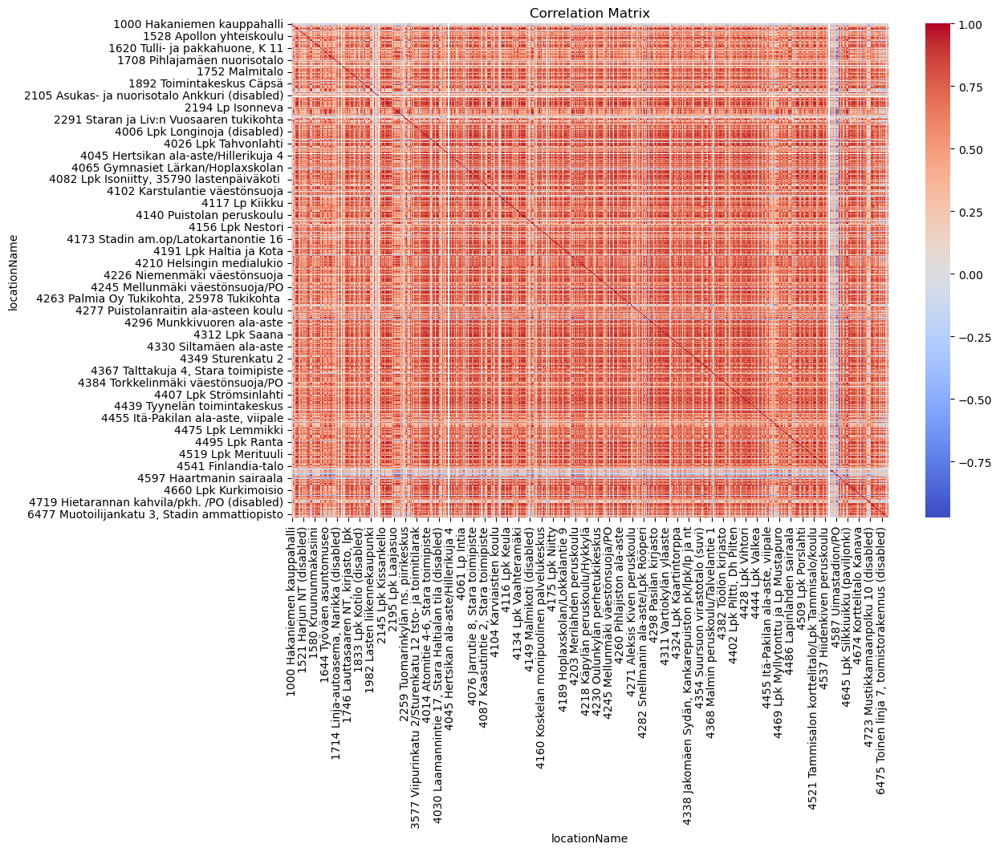

In [19]:
import matplotlib.pyplot as plt
import seaborn as sns
# heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=False)
plt.title('Correlation Matrix')
plt.show()

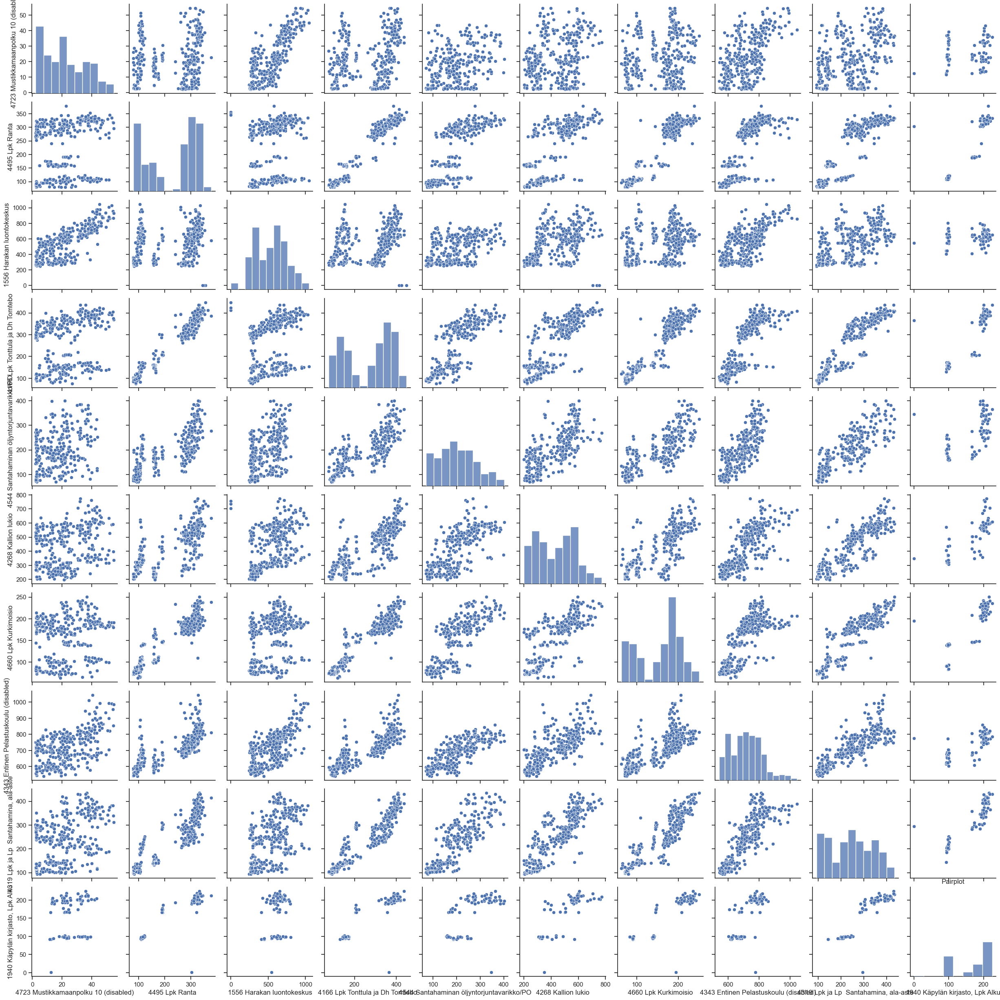

In [20]:
import seaborn as sns
import matplotlib.pyplot as plt
import random

# Randomly selected 10 locations
random_locations = random.sample(list(pivot_df.columns), 10)

# a subset of the data with the random locations
subset_df = pivot_df[random_locations]

# a pairplot
sns.set(style="ticks")
sns.pairplot(subset_df)
plt.title('Pairplot')
plt.show()


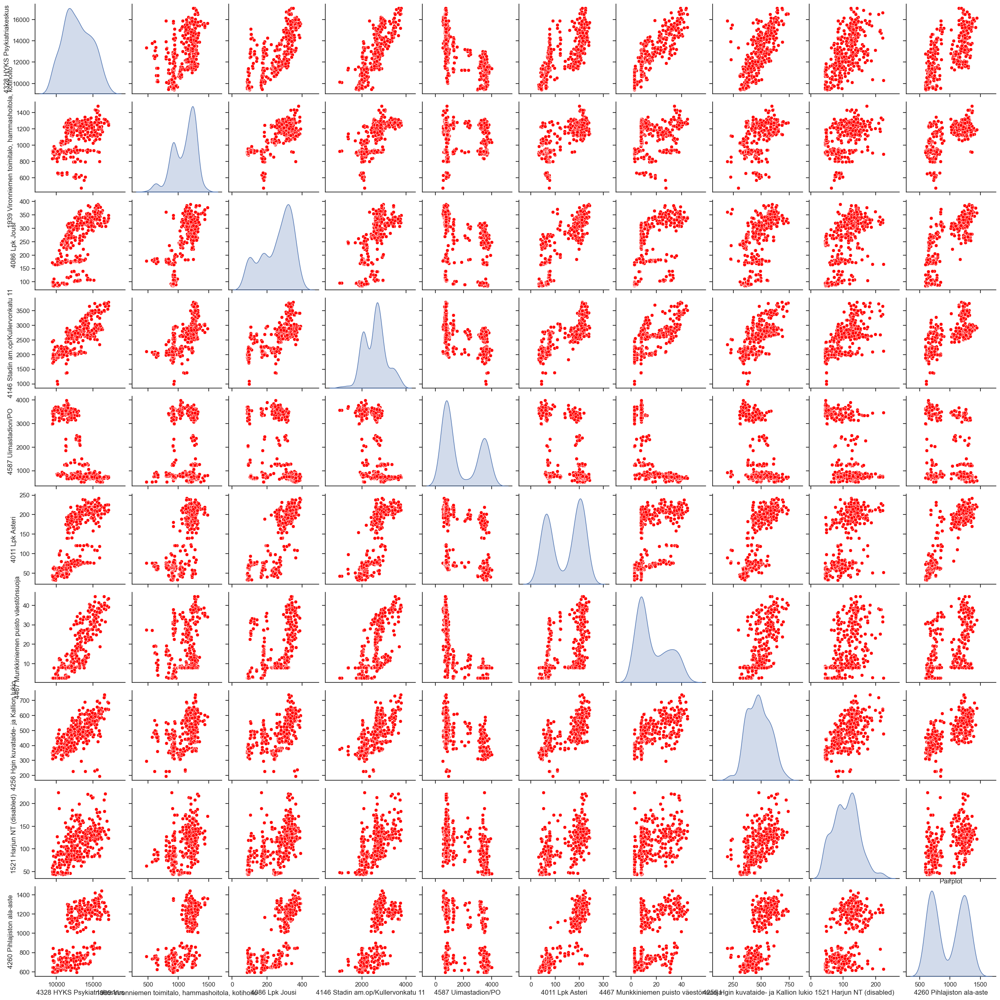

In [21]:
import seaborn as sns
import matplotlib.pyplot as plt
import random

# Randomly selected 10 locations
random_locations = random.sample(list(pivot_df.columns), 10)

# a subset of the data with the random locations
subset_df = pivot_df[random_locations]

# Reset the index to include the timestamp as a column
subset_df = subset_df.reset_index()

# a pairplot with a single color for all data points
sns.set(style="ticks")
sns.pairplot(subset_df, vars=random_locations, diag_kind='kde', plot_kws={'color': 'red'})
plt.title('Pairplot')
plt.show()

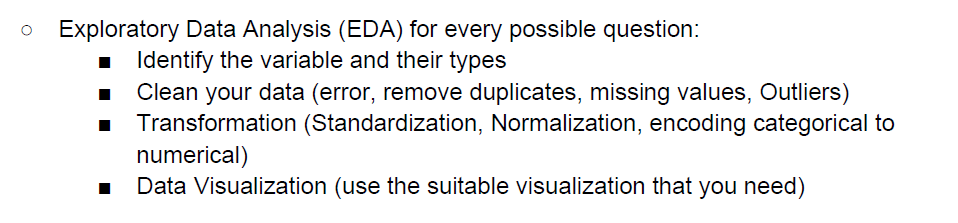

In [22]:
# Checking the missing values in each coulmn

missing_values = selected_data.isnull().sum()
print(missing_values)

0


In [23]:
import pandas as pd

# Identify the variables and their types
variable_types = df.dtypes

print(variable_types)


timestamp         datetime64[ns]
reportingGroup            object
locationName              object
value                    float64
unit                      object
dtype: object


In [24]:
has_errors = False
print("Errors in DataFrame:")

# Check for missing values in each column
for column in df.columns:
    if df[column].isnull().any():
        has_errors = True
        print("Error: Missing values found in column:", column)
        print(df[df[column].isnull()])

# Check for non-numeric values in the 'value' column
if df['value'].dtype != float:
    print("Error: Non-numeric values found in column: value")
    has_errors = True

# Check for out-of-range errors in the 'value' column
errors = df[(df['value'] < df['value'].min()) | (df['value'] > df['value'].max())]
if not errors.empty:
    has_errors = True
    print("Errors found in column: value")
    print(errors)

if not has_errors:
    print("No errors found in DataFrame")


Errors in DataFrame:
No errors found in DataFrame


# Finding outliers using IQR and visualize using Boxplot

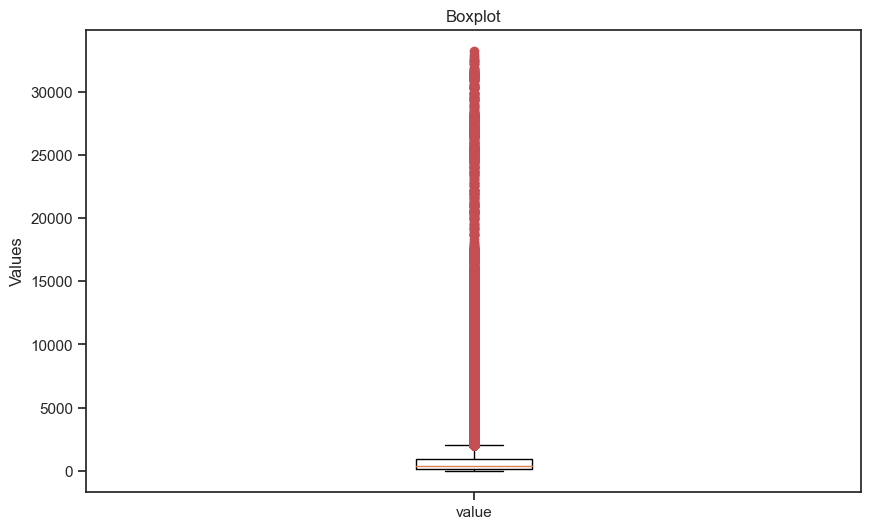

In [26]:
import numpy as np
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
numeric_columns = ['value'] 
bp = plt.boxplot(df[numeric_columns].values, showfliers=False)
plt.title('Boxplot')
plt.xticks(range(1, len(numeric_columns) + 1), numeric_columns)
plt.ylabel('Values')

for j, column in enumerate(numeric_columns, 1):
    column_values = df[column].values
    q1 = np.nanpercentile(column_values, 25)
    q3 = np.nanpercentile(column_values, 75)
    iqr = q3 - q1
    outlier_threshold = 1.5 * iqr
    column_outliers = column_values[((column_values < q1 - outlier_threshold) | (column_values > q3 + outlier_threshold))]
    for outlier in column_outliers:
        plt.plot(j, outlier, 'ro', label='Outlier')

plt.show()


In [27]:
import pandas as pd
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt

def detect_outliers(data, threshold=1.5):
    outliers = None
    
    if pd.api.types.is_numeric_dtype(data):
        alpha = 0.05
        stat, p = stats.shapiro(data.dropna())

        if p > alpha:
            # Normal distribution, using Z-score method (Shapiro-Wilk test)
            z_scores = np.abs(stats.zscore(data))
            outliers = data[z_scores > threshold]
        else:
            # Non-normal distribution, use Tukey's method
            q1 = np.percentile(data, 25)
            q3 = np.percentile(data, 75)
            iqr = q3 - q1
            lower_bound = q1 - threshold * iqr
            upper_bound = q3 + threshold * iqr
            outliers = data[(data < lower_bound) | (data > upper_bound)]
    
    return outliers

E:\Jupyter notebook\lib\site-packages\scipy\stats\_morestats.py:1816: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


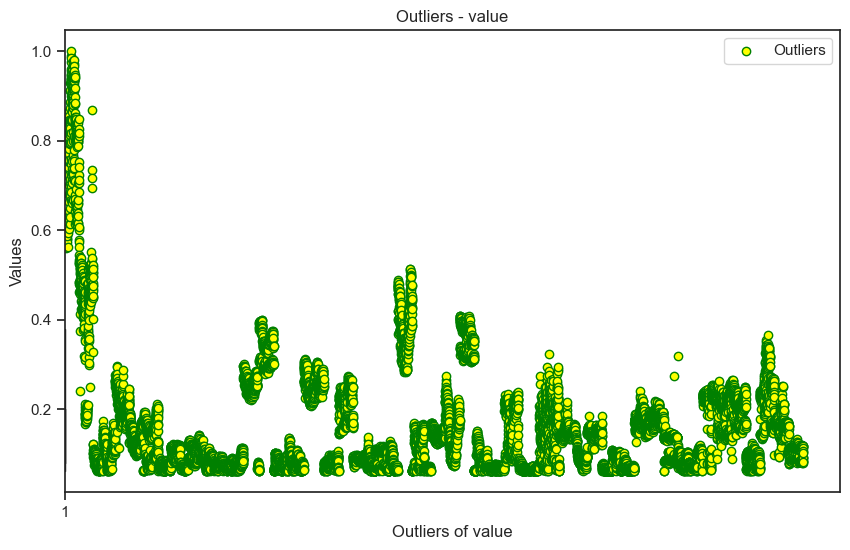

Total outliers in column value: 18388


In [38]:
def visualize_outliers(column_name, outliers):
    if outliers is not None:
        plt.figure(figsize=(10, 6))
        plt.boxplot(outliers.values, showfliers=False)
        plt.scatter(range(1, len(outliers)+1), outliers.values, color='yellow', marker='o', edgecolors='green', label='Outliers')
        plt.xlabel('Outliers of ' + column_name)
        plt.ylabel('Values')
        plt.title('Outliers - ' + column_name)
        plt.legend()
        plt.show()
        print("Total outliers in column", column_name + ":", len(outliers))
    else:
        print('No outliers detected for column:', column_name)

# Detect outliers for each column
outliers_value = detect_outliers(df['value'])

# Visualize outliers for each column
visualize_outliers('value', outliers_value)

In [32]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler

# numeric columns for transformation
numeric_columns = df.select_dtypes(include=np.number).columns

# Standardization
scaler = StandardScaler()
df[numeric_columns] = scaler.fit_transform(df[numeric_columns])

# Normalization
minmax_scaler = MinMaxScaler()
df[numeric_columns] = minmax_scaler.fit_transform(df[numeric_columns])

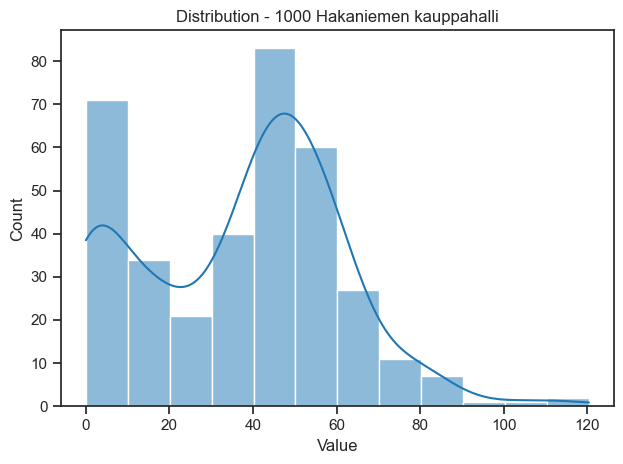

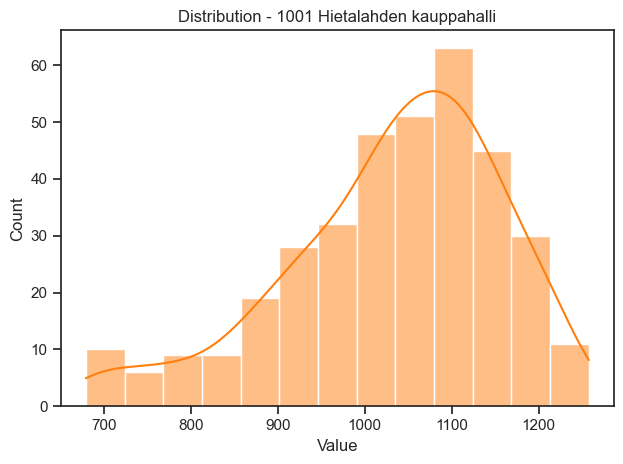

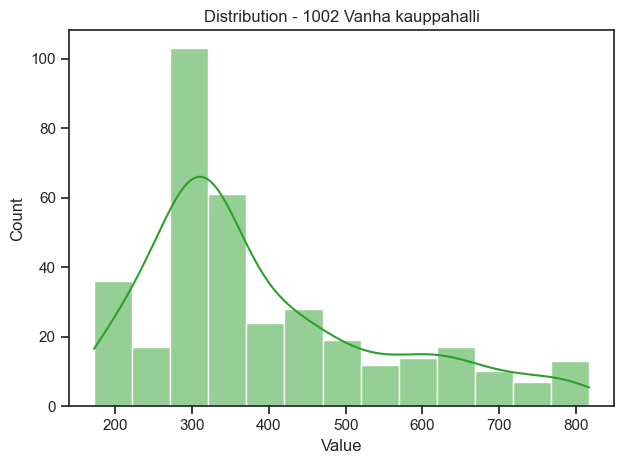

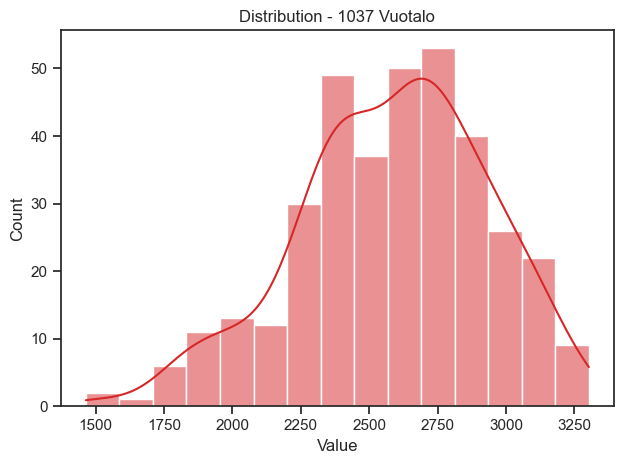

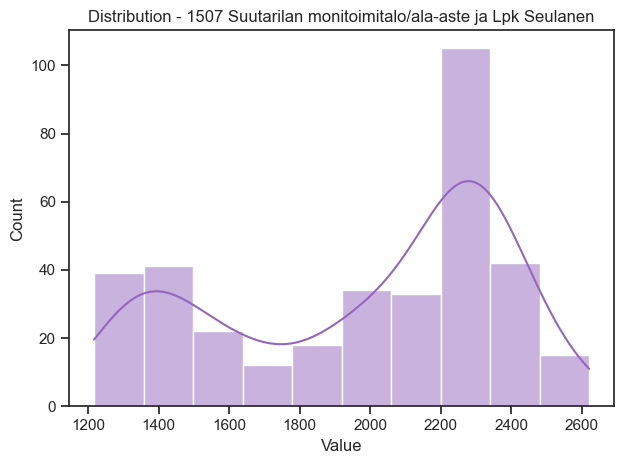

...

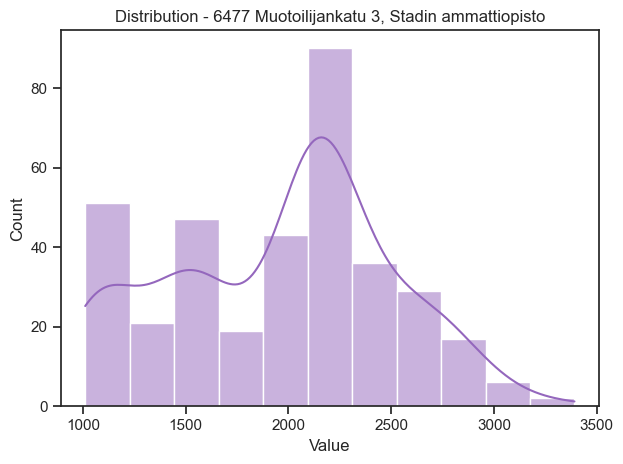

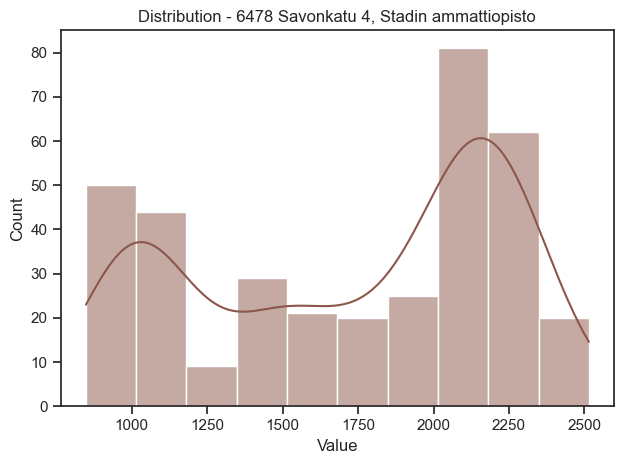

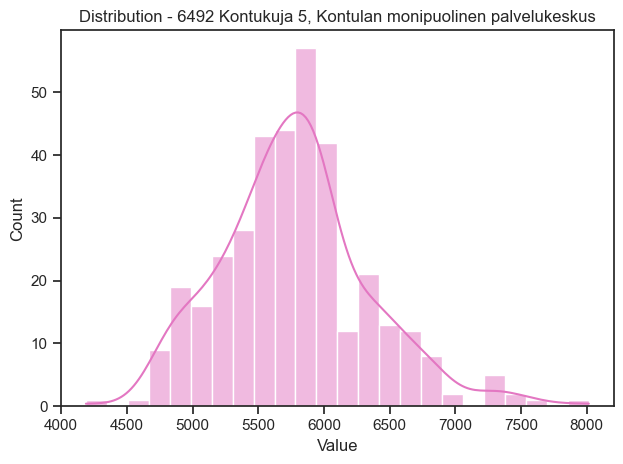

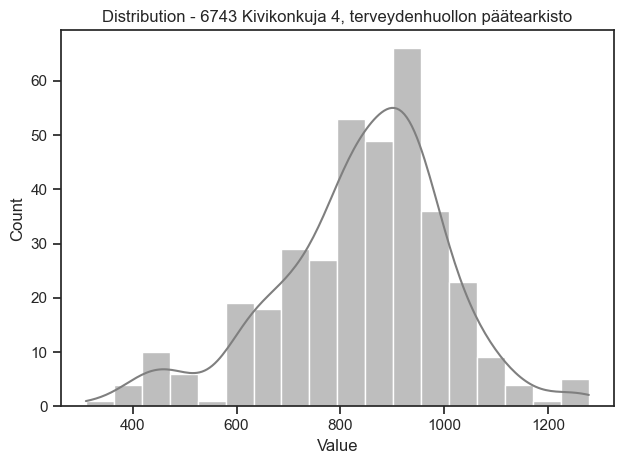

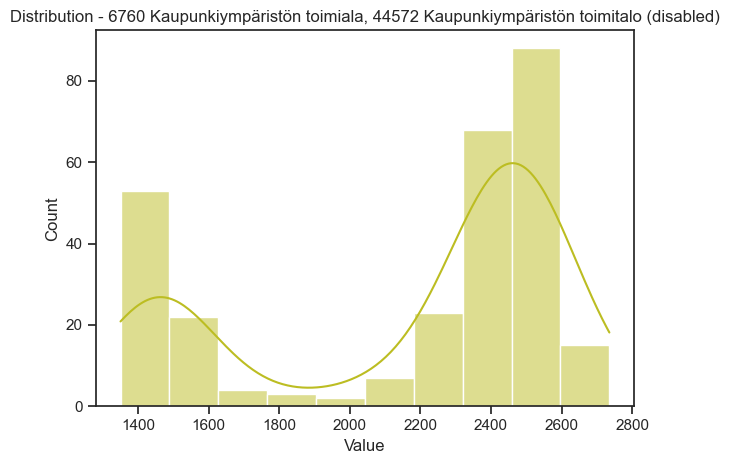

In [33]:
import seaborn as sns

# a color palette with the number of unique locations
num_locations = len(df['locationName'].unique())
colors = sns.color_palette('tab10', num_locations)

# Group the data by unique locations
grouped_df = df.groupby('locationName')

for i, (location, data) in enumerate(grouped_df):
    ax = sns.histplot(data['value'], kde=True, color=colors[i])
    plt.title(f'Distribution - {location}')
    plt.xlabel('Value')
    plt.ylabel('Count')
    plt.tight_layout()
    plt.show()

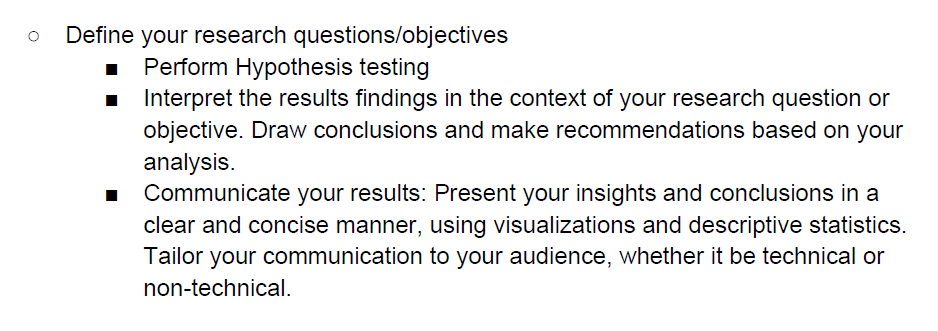

In [17]:
import pandas as pd
from scipy import stats

# Extract the electricity consumption values for the two specific locations
location1 = df[df['locationName'] == '1000 Hakaniemen kauppahalli']['value']
location2 = df[df['locationName'] == '2195 Lpk Laajasuo']['value']

# Perform the two-sample t-test
t_stat, p_value = stats.ttest_ind(location1, location2)

if p_value < 0.05:
    print("The Null Hypothesis rejected .")
    print("There is a significant difference in mean electricity consumption between the two locations.")
else:
    print("Fail to reject the Null Hypothesis.")
    print("There is no significant difference in mean electricity consumption between the two locations.")

The Null Hypothesis rejected .
There is a significant difference in mean electricity consumption between the two locations.


- The code compares the p-value (probability value) against a significance level (0.05) to make a decision about the Null Hypothesis.
- If the p-value is less than the significance level (p < 0.05), the Null Hypothesis is rejected.
- In this case, the Null Hypothesis is rejected, indicating that there is a significant difference in mean electricity consumption between the two locations.

Based on the results, it can be concluded that there is a statistically significant difference in mean electricity consumption between the two locations being compared.
The specific locations, '1000 Hakaniemen kauppahalli' and '2195 Lpk Laajasuo,' show distinct electricity consumption patterns.
Further investigation can be conducted to explore the factors contributing to the observed differences, such as building characteristics, usage patterns, or energy efficiency measures.
Recommendations can be made based on the findings to optimize electricity consumption in each location, potentially leading to cost savings and improved energy efficiency.